# Colab notebook of the Bachelor thesis: The analysis and application of image processing algorithms

## Vince Pongracz

# Setting up the environment

### Mount GDrive

Mount the GDrive path, where all the data go

In [147]:
# Mount GDrive

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Import libraries and packages

Import every required packages and libraries to run this notebook.

Run analysis on environment (check GPU availability and prompt GPU properties)

In [204]:
# Imports

# os
import os

# tensorflow
import tensorflow as tf

# tensorflow addons
# https://www.tensorflow.org/addons/overview
!pip install tensorflow-addons
import tensorflow_addons as tfa

# keras
from keras import datasets, layers, models, Input, Model
from keras.models.cloning import Sequential
from keras.engine.data_adapter import train_validation_split
from keras.models import load_model
from keras.layers import Layer, Dense, Dropout, Activation, Flatten, Conv2D, MaxPooling2D, Add, Input

# check GPU access
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))
print(tf.test.gpu_device_name())

print('---')
# list datasets
print('Available datasets:')
!ls -l drive/MyDrive/bscThesis/data

print('---')
#python
print('Python version:')
!python3 --version

print('---')
# get GPU info
!nvidia-smi

print('---')
# pandas
!pip install pandas==1.3.5
import pandas as pd
print(f'pandas version: {pd.__version__}')

# numpy
import numpy as np

# debug
# https://zohaib.me/debugging-in-google-collab-notebook/
# !pip install -Uqq ipdb
# import ipdb
# %pdb on

# datasets
!pip install datasets
from datasets import Dataset, Features
import datasets

# ipyplot
!pip install ipyplot
import ipyplot

# plotly
import plotly.express as px

# kaleido - saving figures
!pip install kaleido==0.1.0
import kaleido
!pip install psutil

# matplotlib
from matplotlib import pyplot as plt

# date handling
from datetime import datetime

# visualkeras
!pip install visualkeras
!apt-get install imagemagick
import visualkeras

# plotmodel
from keras.utils.vis_utils import plot_model

print('-----')
print('Config session done!')

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Num GPUs Available:  1
/device:GPU:0
---
Available datasets:
total 50102
-rw------- 1 root root 26174616 Oct 25 11:11 dataframe_all.hdf5
-rw------- 1 root root 25116484 Oct 25 11:11 dataframe_all.pkl
drwx------ 2 root root     4096 Nov 15 12:14 ds
drwx------ 2 root root     4096 Nov 28 23:38 ds_mixed
drwx------ 2 root root     4096 Nov 28 16:48 ds_szakest
---
Python version:
Python 3.8.15
---
Mon Dec  5 13:01:32 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MI

Init tensorboard

In [205]:
# tensorboard
# https://www.tensorflow.org/tensorboard/graphs
# https://medium.com/@today.rafi/tensorboard-in-google-colab-bd49fa554f9b
# http://hoolihan.net/blog-tim/2018/07/13/using-tensorboard-with-multiple-model-runs/

%load_ext tensorboard
%tensorboard --logdir logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1990), started 3:51:01 ago. (Use '!kill 1990' to kill it.)

<IPython.core.display.Javascript object>

# Load and split dataset

Load and split datasets from GDrive, transform them to ndarray

In [206]:

def loadDataset(path: str = 'drive/MyDrive/bscThesis/data/ds') -> Dataset:
    ds = datasets.load_from_disk(path)
    print('load done')
    return ds

print('--- start ---')

print('load&preprocess data from drive')

drivePath = 'drive/MyDrive/bscThesis/data'
# to ensure always the same data split
seed: int = 42

# -----------------------
# SPECIFY RUN NAME
run_name: str = 'ready'
augment: bool = True
# -----------------------

ds_konstanz: str = 'drive/MyDrive/bscThesis/data/ds'
ds_szakest: str = 'drive/MyDrive/bscThesis/data/ds_szakest'
ds_mixed: str = 'drive/MyDrive/bscThesis/data/ds_mixed'
ds = loadDataset(ds_konstanz)

# shuffle dataset
ds = ds.shuffle(seed=seed)

# do not shuffle at the split that was already arranged
ds = ds.train_test_split(test_size=0.2, shuffle=False)
train, test = ds['train'], ds['test']

train_x, train_y = train['img'], train['exif']
test_x, test_y = test['img'], test['exif']
 

--- start ---
load&preprocess data from drive
load done


In [207]:
train_y = np.asarray(train_y, dtype=np.float32)
test_y = np.asarray(test_y, dtype=np.float32)

# Augmentation

Define augmentation layers and specify augmentation factor (how many times should the augmentation run)

In [208]:
# setup augmentation network
data_augmentation = tf.keras.Sequential([
    layers.RandomFlip("horizontal_and_vertical"),
    layers.RandomRotation(0.08), # fill_mode='constant'
  ])

augment_factor: int = 1

### Other ideas for augmentation - old

One of the first ideas for data augmentation

```python
# augmentation
# https://www.tensorflow.org/api_docs/python/tf/keras/layers/RandomRotation
if augment and False:  
  augmented = []
  for (x, y) in zip(train_x, train_y):
      augm = data_augmentation(x, training=True), y
      augmented.append(augm)  

  for a in augmented:
    x, y = a
    train_x.append(x)
    train_y.append(y)

# 2nd idea
from keras.preprocessing.image import ImageDataGenerator

# https://machinelearningmastery.com/image-augmentation-deep-learning-keras/

datagen = ImageDataGenerator(
    rotation_range=20,
    horizontal_flip=True,
    vertical_flip=True,
    fill_mode='reflect'
)

# 3rd idea
def data_generator(x, y):
    N = len(x)
    i = 0
    while True:
        yield data_augmentation(x[i], training=True), y[i]
        i = i + 1
        if i + 1 > N:
            i = 0
```

### Show validation images

Plot augmented images



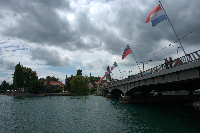
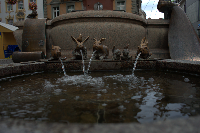
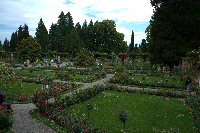
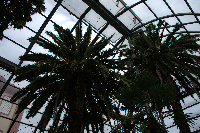
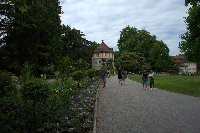
...
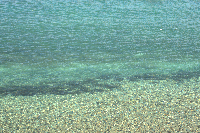
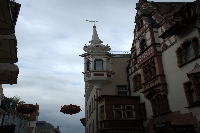
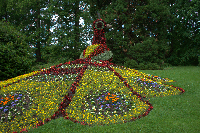
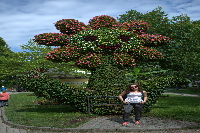
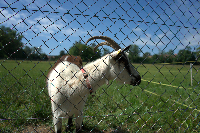

In [209]:
# show augmented images
print('Plot augmented images')
ipyplot.plot_images(test_x, img_width=200)

### Data augmentation

Run data augmentation and add augmented images to the training and test sets

In [210]:
# improved augmentation
# https://machinelearningmastery.com/a-gentle-introduction-to-tensorflow-data-api/

for i in range(augment_factor):
    if augment:
        # train
        tmp = tf.data.Dataset.from_tensor_slices((train_x, train_y))
        tmp = tmp.map(lambda x, y: (data_augmentation(x, training=True), y))
        tmp = list(tmp.as_numpy_iterator())
        print(f'#augmented images: {len(tmp)}')
        train_xa, train_ya = zip(*tmp) # inverse zip function
        train_xa = np.asarray(list(train_xa))
        train_ya = np.asarray(list(train_ya))

        train_x = np.append(train_x, train_xa, axis=0)
        train_y = np.append(train_y, train_ya, axis=0)

if augment:
    # test
    tmp = tf.data.Dataset.from_tensor_slices((test_x, test_y))
    tmp = tmp.map(lambda x, y: (data_augmentation(x, training=True), y))
    tmp = list(tmp.as_numpy_iterator())
    print(f'#augmented images: {len(tmp)}')
    test_xa, test_ya = zip(*tmp) # inverse zip function
    test_xa = np.asarray(list(test_xa))
    test_ya = np.asarray(list(test_ya))

    test_x = np.append(test_x, test_xa, axis=0)
    test_y = np.append(test_y, test_ya, axis=0)

    

#augmented images: 53
#augmented images: 14


Plot augmented images



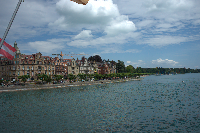
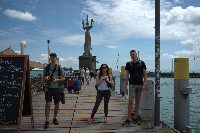
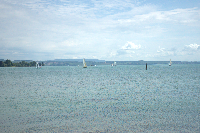
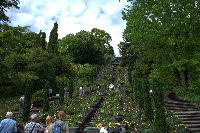
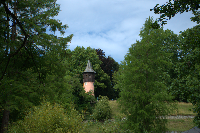
...
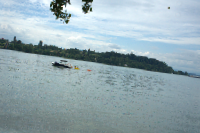
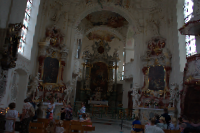
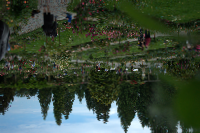
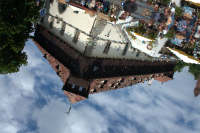
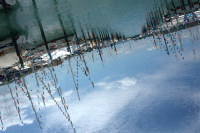

In [211]:
if augment:
    print('Plot augmented images')
    ipyplot.plot_images(train_x[40:], img_width=200, max_images=120)

### Standardize input data

re-centre and re-scale images 

In [212]:
# standardize dataset
standardize: bool = True

if standardize:
    train_x = tf.image.per_image_standardization(train_x).numpy()
    # train_x = tf.convert_to_tensor(train_x)
    test_x = tf.image.per_image_standardization(test_x).numpy()
    # test_x = tf.convert_to_tensor(test_x)

Extract each target feature lists from the main target data structure

In [213]:
def separate_targets(target_values: np.ndarray, with_output_normalization: bool = False):
    wb = []
    tint = []
    expo = []
    contrast = []
    vibr = []
    for val in target_values:
        [w, t, e, c, v] = val
        wb.append(w)
        tint.append(t)
        expo.append(e)
        contrast.append(c)
        vibr.append(v)
    wb = np.asarray(wb)
    tint = np.asarray(tint)
    expo = np.asarray(expo)
    contrast = np.asarray(contrast)
    vibr = np.asarray(vibr)
    outls = [wb, tint, expo, contrast, vibr]
    if with_output_normalization:
        others = []
        for f in outls:
            oth = (np.mean(f) - f) / (np.std(f) + 0.0001)
            others.append(oth)
        return np.asarray(others)
    return outls

In [214]:
# end of data preprocessing
[train_wb_y, train_tint_y, train_expo_y, train_contr_y, train_vibr_y] = separate_targets(train_y)
# train_wb_y = train_wb_y / 1000 #(np.mean() - train_wb_y) / (np.std(train_wb_y) + 1e-12)
train_y_lists = [train_wb_y, train_tint_y, train_expo_y, train_contr_y, train_vibr_y]

[test_wb_y, test_tint_y, test_expo_y, test_contr_y, test_vibr_y] = separate_targets(test_y)
# test_wb_y = test_wb_y / 1000 # (np.mean(test_wb_y) - test_wb_y) / (np.std(test_wb_y) + 1e-12)
test_y_lists = [test_wb_y, test_tint_y, test_expo_y, test_contr_y, test_vibr_y]

print('preprocessing done')

preprocessing done


# NN definitions

Set up neural nets

In [258]:
# global dropout for every neural net
dropout_rate: float = 0.1

# shorts for layers
glob_avgpool = layers.GlobalAveragePooling2D
glob_maxpool = layers.GlobalMaxPooling2D
avgpool = layers.AveragePooling2D
maxpool = layers.MaxPooling2D

flatten = layers.Flatten

## Residual block definition - old

Python code, which is not in use, it was faulty as I remember.
```python

# https://stackoverflow.com/questions/51337558/how-to-import-keras-engine-topology-in-tensorflow

# source:
# https://gist.github.com/FirefoxMetzger/6b6ccf4f7c344459507e73bbd13ec541

# https://medium.com/swlh/how-to-create-a-residual-network-in-tensorflow-and-keras-cd97f6c62557
class Residual(Layer):
    def __init__(self, channels_in: int = 32, kernel: tuple = (3,3),**kwargs):
        super(Residual, self).__init__(**kwargs)
        self.channels_in = channels_in
        self.kernel = kernel

    def call(self, x):
        # the residual block using Keras functional API
        first_layer =   Activation("linear", trainable=False)(x)
        x =             Conv2D( self.channels_in,
                                self.kernel,
                                padding="same")(first_layer)
        x =             Activation("relu")(x)
        x =             Conv2D( self.channels_in,
                                self.kernel,
                                padding="same")(x)
        residual =      Add()([x, first_layer])
        x =             Activation("relu")(residual)
        return x

    def compute_output_shape(self, input_shape):
        return input_shape

```

## Setup NN topology plotting

Set up properties for saving figures and statistics

In [259]:
# plotting the model structures
# https://machinelearningmastery.com/visualize-deep-learning-neural-network-model-keras/
date = datetime.now()
currDate = '{:04d}{:02d}{:2d}_{:02d}{:2d}{:2d}'.format(date.year, date.month, date.day, date.hour, date.minute, date.second )
nn_plot_path: str = f'drive/MyDrive/bscThesis/plots/{currDate}'

scale: float = 1.2

# plotting with visualkeras
# https://www.analyticsvidhya.com/blog/2022/03/visualize-deep-learning-models-using-visualkeras/


## BuildNNs: buildNN_init

build function of buildNN_init net

In [260]:

# about kernel sizes at convolution
# https://medium.com/analytics-vidhya/how-to-choose-the-size-of-the-convolution-filter-or-kernel-size-for-cnn-86a55a1e2d15

def buildNN_init(input_shape: tuple, output_shape: int, showModel: bool = False, 
            with_dropuot: bool = True, with_normalization: bool = True,
            name: str = 'buildNN_init') -> Sequential:
    model = models.Sequential(name=name)

    model.add(layers.Conv2D(64, (3, 3), activation='relu', input_shape=input_shape))
    model.add(layers.MaxPooling2D((2, 2)))
    if with_normalization: 
        model.add(layers.BatchNormalization())
    
    for i in range(4):
        model.add(layers.Conv2D(128, (3, 3), activation='relu', ))
        model.add(layers.MaxPooling2D((2, 2)))
        if with_normalization: 
            model.add(layers.BatchNormalization())
        
    model.add(glob_avgpool())

    model.add(layers.Dense(128, activation='relu'))
    if with_dropuot:
        model.add(layers.Dropout(dropout_rate))
    model.add(layers.Dense(64, activation='relu'))
    if with_dropuot:
        model.add(layers.Dropout(dropout_rate))
    model.add(layers.Dense(64, activation='relu'))
    model.add(layers.Dense(output_shape, activation='linear'))

    if showModel:
        model.summary()
        # visualkeras.layered_view(model, legend=True).show() # without custom font
        visualkeras.layered_view(model, scale_xy=scale,legend=True, to_file='buildNN_init_plot.png')
        # plot_model(model, to_file=f'{nn_plot_path}{os.path.sep}buildNN_init_plot.png', show_shapes=True, show_layer_names=True)

    return model


## Build NNs: buildNN_s

build function of buildNN_s net

In [261]:
def buildNN_s(input_shape: tuple, output_shape: int, showModel: bool = False, 
              with_dropuot: bool = True, with_normalization: bool = True,
              name: str = 'buildNN_s') -> Sequential:
    model = models.Sequential(name=name)

    model.add(layers.Conv2D(16, (3, 3), activation='relu', input_shape=input_shape))
    model.add(layers.MaxPooling2D((2, 2), ))
    if with_normalization: 
        model.add(layers.BatchNormalization())
    model.add(layers.Conv2D(32, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    if with_normalization: 
        model.add(layers.BatchNormalization())
    model.add(layers.Conv2D(32, (3, 3), activation='relu'))

    model.add(glob_avgpool())

    model.add(layers.Dense(64, activation='relu'))
    if with_dropuot:
        model.add(layers.Dropout(dropout_rate))
    model.add(layers.Dense(32, activation='relu'))
    if with_dropuot:
        model.add(layers.Dropout(dropout_rate))
    model.add(layers.Dense(output_shape, activation='linear'))

    if showModel:
        model.summary()
        visualkeras.layered_view(model, scale_xy=scale, legend=True, to_file='buildNN_s_plot.png')
        # plot_model(model, to_file=f'{nn_plot_path}{os.path.sep}buildNN_s_plot.png', show_shapes=True, show_layer_names=True)

    return model

## Build NNs: buildNN_xs

build function of buildNN_xs net


In [262]:
def buildNN_xs(input_shape: tuple, output_shape: int, showModel: bool = False, 
               with_dropuot: bool = True, with_normalization: bool = True,
               name: str = 'buildNN_xs') -> Sequential:
    model = models.Sequential(name=name)

    model.add(layers.Conv2D(16, (3, 3), activation='relu', input_shape=input_shape))
    model.add(layers.MaxPooling2D((2, 2)))
    if with_normalization: 
        model.add(layers.BatchNormalization())
    model.add(layers.Conv2D(32, (3, 3), activation='relu'))    

    model.add(glob_avgpool())

    model.add(layers.Dense(32, activation='relu'))
    if with_dropuot:
        model.add(layers.Dropout(dropout_rate))
    model.add(layers.Dense(16, activation='relu'))
    model.add(layers.Dense(output_shape, activation='linear'))

    if showModel:
        model.summary()
        visualkeras.layered_view(model,  scale_xy=scale, legend=True, to_file='buildNN_xs_plot.png')
        # plot_model(model, to_file=f'{nn_plot_path}{os.path.sep}buildNN_xs_plot.png', show_shapes=True, show_layer_names=True)

    return model

## Build NNs: buildNN_xxs

test purposes and early stage net

build function of buildNN_xxs net

In [263]:
def buildNN_xxs(input_shape: tuple, output_shape: int, showModel: bool = False, 
               with_dropuot: bool = True, with_normalization: bool = True,
               name: str = 'buildNN_xxs') -> Sequential:
    model = models.Sequential(name=name)

    model.add(layers.Conv2D(8, (3, 3), activation='relu', input_shape=input_shape))
    model.add(layers.MaxPooling2D((2, 2)))
    if with_normalization: 
        model.add(layers.BatchNormalization())
    model.add(layers.Conv2D(16, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    if with_normalization: 
        model.add(layers.BatchNormalization())

    model.add(glob_avgpool())

    model.add(layers.Dense(16, activation='relu'))
    if with_dropuot:
        model.add(layers.Dropout(dropout_rate))
    model.add(layers.Dense(8, activation='relu'))
    model.add(layers.Dense(output_shape, activation='linear'))

    if showModel:
        model.summary()
        visualkeras.layered_view(model,  scale_xy=scale, legend=True, to_file='buildNN_xxs_plot.png')
        # plot_model(model, to_file=f'{nn_plot_path}{os.path.sep}buildNN_xxs_plot.png', show_shapes=True, show_layer_names=True)

    return model

## BuildNNs: buildNN_RCNN

build function of buildNN_RCNN net

In [264]:
# https://www.tutorialspoint.com/how-can-functional-api-be-used-to-work-with-residual-connections-in-python
# Built with keras functional API

def buildNN_RCNN(input_shape: tuple, output_shape: int, showModel: bool = False,
                 with_dropuot: bool = True, with_normalization: bool = True,
                 name: str = 'buildNN_RCNN') -> Model:

    img_inputs = layers.Input(shape=input_shape)

    x = layers.Conv2D(32, 3, activation="relu", padding="same")(img_inputs)
    x = layers.MaxPooling2D(2)(x)
    if with_normalization: 
        x = layers.BatchNormalization()(x)
    block_0_output = x
    
    x = layers.Conv2D(32, 3, activation="relu", padding="same")(x)
    if with_normalization: 
        x = layers.BatchNormalization()(x)
    block_1_output = layers.add([x, block_0_output])
    x = Activation('relu')(block_1_output)
    if with_normalization: 
        x = layers.BatchNormalization()(x)
    
    x = layers.Conv2D(32, 3, activation="relu", padding="same")(x)
    if with_normalization: 
        x = layers.BatchNormalization()(x)
    
    block_2_output = layers.add([x, block_1_output])
    x = Activation('relu')(block_2_output)
    if with_normalization: 
        x = layers.BatchNormalization()(x)
    
    x = layers.Conv2D(128, 3, activation="relu", padding="same")(x)
    
    x =  glob_avgpool()(x)
    
    x = layers.Dense(128, activation="relu")(x)
    if with_dropuot:
        x = layers.Dropout(dropout_rate)(x)
    x = layers.Dense(64, activation="relu")(x)
    if with_dropuot:
        x = layers.Dropout(dropout_rate)(x)
    x = layers.Dense(32, activation="relu")(x)
    outputs = layers.Dense(output_shape)(x)   

    model = Model(inputs=img_inputs, outputs=outputs, name=name)

    if showModel:
        model.summary()
        visualkeras.layered_view(model, scale_xy=scale, legend=True, to_file='buildNN_RCNN_plot.png')
        # plot_model(model, to_file=f'{nn_plot_path}{os.path.sep}buildNN_RCNN_plot.png', show_shapes=True, show_layer_names=True)

    return model

## Build NNs: buildNN_augment

build function of buildNN_augment

Not in use, augmentation works not like this. Shame, would have been great solution.

```python
def buildNN_augment(input_shape: tuple, output_shape: int, showModel: bool = False, 
            with_dropuot: bool = True, with_normalization: bool = True,
            name: str = 'buildNN_augment') -> Sequential:
    model = models.Sequential(name=name)

    h, w, d = input_shape

    # https://www.tensorflow.org/tutorials/images/data_augmentation
    data_augmentation = tf.keras.Sequential([
        layers.Resizing(h, w),
        layers.RandomFlip('horizontal'),
        layers.RandomRotation(0.1),
    ])
    model.add(data_augmentation)

    # , input_shape=input_shape
    model.add(layers.Conv2D(64, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(128, (3, 3), activation='relu'))
    if with_normalization: 
        model.add(layers.BatchNormalization())
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(128, (3, 3), activation='relu'))

    model.add(layers.Flatten())

    model.add(layers.Dense(128, activation='relu'))
    if with_dropuot:
        model.add(layers.Dropout(0.1))
    model.add(layers.Dense(64, activation='relu'))
    if with_dropuot:
        model.add(layers.Dropout(0.1))
    model.add(layers.Dense(64, activation='relu'))
    model.add(layers.Dense(output_shape, activation='linear'))

    if showModel:
        model.summary()
        model.build(input_shape)
        visualkeras.layered_view(model, scale_xy=scale, legend=True, to_file='buildNN_augment_plot.png')
        # plot_model(model, to_file=f'{nn_plot_path}{os.path.sep}buildNN_augment_plot.png', show_shapes=True, show_layer_names=True)

    return model
```

## Build NNs: buildNN_pretrained

build function of buildNN_pretrained net

In [265]:
# https://keras.io/guides/transfer_learning/

# Requires additional preprocessing

def buildNN_pretrained(input_shape: tuple, output_shape: int, showModel: bool = False, 
            with_dropuot: bool = True, with_normalization: bool = True,
            name: str = 'buildNN_pretrained') -> (models.Sequential, models.Sequential):
 
    # probably worth to try - smallest pretrained network which I have found on keras.io
    # base_model = tf.keras.applications.MobileNetV2(input_shape=input_shape, include_top=False)
    # base_model = tf.keras.applications.DenseNet121(input_shape=input_shape, include_top=False)
    # base_model = tf.keras.applications.InceptionV3(include_top=False, input_shape=input_shape)
    
    base_model = tf.keras.applications.MobileNetV2(input_shape=input_shape, include_top=False)
    base_model.trainable = False
    
    model = models.Sequential(name=name)
    model.add(base_model)

    model.add(glob_avgpool())

    # top of buildNN_init:
    model.add(layers.Dense(128, activation='relu'))
    if with_dropuot:
        model.add(layers.Dropout(dropout_rate))
    model.add(layers.Dense(64, activation='relu'))
    if with_dropuot:
        model.add(layers.Dropout(dropout_rate))
    model.add(layers.Dense(64, activation='relu'))
    model.add(layers.Dense(output_shape, activation='linear'))

    if showModel:
        model.summary()
        visualkeras.layered_view(model, scale_xy=scale, legend=True, to_file='buildNN_pretrained_plot.png')
        # plot_model(model, to_file=f'{nn_plot_path}{os.path.sep}buildNN_pretrained_plot.png', show_shapes=True, show_layer_names=True)

    return model, base_model

## BuildNNs: buildNN_irV2

build function of buildNN_ir2 net


In [266]:
def buildNN_xsV2(input_shape: tuple, output_shape: int, showModel: bool = False, 
               with_dropuot: bool = True, with_normalization: bool = True,
               name: str = 'buildNN_irV2') -> Sequential:

    img_inputs = layers.Input(shape=input_shape)

    x = layers.Conv2D(64, 3, activation="relu", padding="same")(img_inputs)
    x = layers.MaxPooling2D(2)(x)
    if with_normalization: 
        x = layers.BatchNormalization()(x)    
    
    x = layers.Conv2D(128, 3, activation="relu", padding="same")(x)
    if with_normalization: 
        x = layers.BatchNormalization()(x)
    x = layers.MaxPooling2D(2)(x)
    block_0_output = x

    x = layers.Conv2D(128, 3, activation="relu", padding="same")(x)
    if with_normalization: 
        x = layers.BatchNormalization()(x)
    block_1_output = layers.add([x, block_0_output])
    x = Activation('relu')(block_1_output)
    if with_normalization: 
        x = layers.BatchNormalization()(x)

    x = layers.Conv2D(256, 3, strides=(2,2), activation="relu", padding="same")(x)
    if with_normalization: 
        x = layers.BatchNormalization()(x)
        
    x =  glob_avgpool()(x)
    
    x = layers.Dense(64, activation="relu")(x)
    if with_dropuot:
        x = layers.Dropout(dropout_rate)(x)
    x = layers.Dense(64, activation="relu")(x)
    if with_dropuot:
        x = layers.Dropout(dropout_rate)(x)
    x = layers.Dense(32, activation="relu")(x)
    outputs = layers.Dense(output_shape)(x)   

    model = Model(inputs=img_inputs, outputs=outputs, name=name)

    if showModel:
        model.summary()
        visualkeras.layered_view(model,  scale_xy=scale, legend=True, to_file='buildNN_xsV2_plot.png')
        # plot_model(model, to_file=f'{nn_plot_path}{os.path.sep}buildNN_xs_plot.png', show_shapes=True, show_layer_names=True)

    return model

# Build NNs:

Configure optimizers, loss functions and early stopping

In [267]:

# Early stopping
patience: int = 100
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=patience, restore_best_weights=True)
early_stopping_short = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=patience, restore_best_weights=True)

# -----------------------
# Schedules
cosdecay_1 = tf.keras.optimizers.schedules.CosineDecayRestarts(1e-3, 10, t_mul=1.0, name='scheduleLR')

# -----------------------
# Optimizers:
adam = tf.keras.optimizers.Adam()
adam2 = tf.keras.optimizers.Adam(learning_rate=cosdecay_1)
adam3 = tf.keras.optimizers.Adam(amsgrad=True)
adam4 = tf.keras.optimizers.Adam(learning_rate=1e-2)
adam_wb = tf.keras.optimizers.Adam()
rms_prop = tf.keras.optimizers.RMSprop() # https://keras.io/api/optimizers/rmsprop/
adagrad = tf.keras.optimizers.Adagrad() # https://keras.io/api/optimizers/adagrad/
adadelta = tf.keras.optimizers.Adadelta(learning_rate=1e-2) # https://keras.io/api/optimizers/adadelta/

# -----------------------
# Losses:
# 'mean_squared_error'
# https://keras.io/api/losses/regression_losses/#meansquarederror-class
mse = tf.keras.losses.MeanSquaredError()

# 'mean_squared_logarithmic_error'
# https://insideaiml.com/blog/MeanSquared-Logarithmic-Error-Loss-1035
# https://keras.io/api/losses/regression_losses/#meansquaredlogarithmicerror-class
msle = tf.keras.losses.MeanSquaredLogarithmicError()

# 'root_mean_squared_error'
# https://en.wikipedia.org/wiki/Root-mean-square_deviation
rmse = tf.keras.metrics.RootMeanSquaredError()

# 'huber_loss'
# https://en.wikipedia.org/wiki/Huber_loss
huber = tf.keras.losses.Huber()

# 'mean_absolute_error'
mae = tf.keras.losses.MeanAbsoluteError()

# 'mean_absolute_percentage_error'
# https://www.tensorflow.org/api_docs/python/tf/keras/losses/MeanAbsolutePercentageError
mape = tf.keras.losses.MeanAbsolutePercentageError()

# TODO
# add metrics: https://keras.io/api/metrics/regression_metrics/#meansquaredlogarithmicerror-class

print('build NNs')

inshape = (133,200,3)
outshape = 1

build NNs


### Models to test and eval

For test purpose: test models instatiations and parametrization

In [268]:
    
# test models
model_wb_0 = buildNN_init(name = 'wb', input_shape=inshape, output_shape=outshape, showModel=True)
model_wb_1 = buildNN_s(name = 'wb1', input_shape=inshape, output_shape=outshape, showModel=True)
model_wb_2 = buildNN_xs(name = 'wb2', input_shape=inshape, output_shape=outshape, showModel=True)
model_wb_3 = buildNN_xxs(name = 'wb3', input_shape=inshape, output_shape=outshape, showModel=True)
model_wb_4 = buildNN_RCNN(name = 'wb4', input_shape=inshape, output_shape=outshape, showModel=True)
model_wb_5, base = buildNN_pretrained(name = 'wb5', input_shape=inshape, output_shape=outshape, showModel=True)
model_wb_6 = buildNN_xsV2(name = 'wb6', input_shape=inshape, output_shape=outshape, showModel=True)

all_loss = huber
#this
# wb - mse
# contrast - huber
model_wb_0.compile(optimizer=adam4, loss=all_loss)
model_wb_1.compile(optimizer=adam4, loss=all_loss)
model_wb_2.compile(optimizer=adam4, loss=all_loss)
model_wb_3.compile(optimizer=adam4, loss=all_loss)
model_wb_4.compile(optimizer=adam4, loss=all_loss)
model_wb_5.compile(optimizer=adam4, loss=all_loss)
#this
# wb - adam, huber
# tint - adam, mae
# expo - huber, mse or mae - does not matter, but early stopping should be scheduled earlier
# contrast - huber is okay
model_wb_6.compile(optimizer=adam4, loss=all_loss)

    

Model: "wb"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_242 (Conv2D)         (None, 131, 198, 64)      1792      
                                                                 
 max_pooling2d_156 (MaxPooli  (None, 65, 99, 64)       0         
 ng2D)                                                           
                                                                 
 batch_normalization_250 (Ba  (None, 65, 99, 64)       256       
 tchNormalization)                                               
                                                                 
 conv2d_243 (Conv2D)         (None, 63, 97, 128)       73856     
                                                                 
 max_pooling2d_157 (MaxPooli  (None, 31, 48, 128)      0         
 ng2D)                                                           
                                                                

Model: "wb5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 mobilenetv2_1.00_224 (Funct  (None, 5, 7, 1280)       2257984   
 ional)                                                          
                                                                 
 global_average_pooling2d_85  (None, 1280)             0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_307 (Dense)           (None, 128)               163968    
                                                                 
 dropout_148 (Dropout)       (None, 128)               0         
                                                                 
 dense_308 (Dense)           (None, 64)                8256      
                                                                 
 dropout_149 (Dropout)       (None, 64)                0       

### Models at the end:

In [269]:
# valid models at the end:
model_wb = buildNN_xsV2(name = 'wb', input_shape=inshape, output_shape=outshape, showModel=True)
model_tint = buildNN_xsV2(name = 'tint', input_shape=inshape, output_shape=outshape, showModel=True)
model_expo = buildNN_xsV2(name = 'expo', input_shape=inshape, output_shape=outshape, showModel=True)
model_contr = buildNN_init(name = 'contr', input_shape=inshape, output_shape=outshape, showModel=True)
model_vibr = buildNN_xsV2(name = 'vibr', input_shape=inshape, output_shape=outshape, showModel=True)

model_wb.compile(optimizer=adam_wb, loss=huber)
model_tint.compile(optimizer=adam, loss=mae)
model_expo.compile(optimizer=adam, loss=mse)
model_contr.compile(optimizer=adam, loss=huber)
model_vibr.compile(optimizer=adam4, loss=huber)
# ------
print('NNs are built')


Model: "wb"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_42 (InputLayer)          [(None, 133, 200, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_262 (Conv2D)            (None, 133, 200, 64  1792        ['input_42[0][0]']               
                                )                                                                 
                                                                                                  
 max_pooling2d_169 (MaxPooling2  (None, 66, 100, 64)  0          ['conv2d_262[0][0]']             
 D)                                                                                              

# Tensorboard configuration

Configure tensorboard callback. The tensorboard statistics will be stored in the runtime, not on the GDrive.

In [227]:
# Tensorboard config

# Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logdir)

# Fit models:

#### Hyperparameter tuning:

Would have been great to use and try these tools:

https://towardsdatascience.com/keras-hyperparameter-tuning-in-google-colab-using-hyperas-624fa4bbf673
https://machinelearningmastery.com/grid-search-hyperparameters-deep-learning-models-python-keras/

In [228]:
def fit_batch(models, train_x, test_x, train_ys, test_ys, epochs, batch_size):
    histories = []
    verbosityLevel = 'auto'

    for (m, tr_y, tst_y) in zip(models, train_ys, test_ys):
        h = m.fit(train_x, tr_y, validation_data=(test_x, tst_y), 
                              batch_size=batch_size, epochs=epochs, verbose=verbosityLevel)
        histories.append(h)

    return histories

### NN fits

Training of neural networks, one at a time.

Configure the number of epochs, batch size and verbosity

In [270]:
print('--- training ---')

default_epochs = 200
batch_size = 4
verbosityLevel = 'auto'

--- training ---


In [271]:
print('WB fit:')
print(f'started: {datetime.now()}')
wb_history = model_wb.fit(train_x, train_wb_y, batch_size=batch_size,
                        validation_data=(test_x, test_wb_y), 
                        epochs=default_epochs*2, verbose=verbosityLevel,
                        callbacks=[early_stopping, tensorboard_callback])

WB fit:
started: 2022-12-05 13:59:19.589412
Epoch 1/400
27/27 [==============================] - 5s 175ms/step - loss: 5267.6455 - val_loss: 5273.7744
Epoch 2/400
27/27 [==============================] - 1s 54ms/step - loss: 5202.3491 - val_loss: 5170.4302
Epoch 3/400
27/27 [==============================] - 0s 15ms/step - loss: 4809.2368 - val_loss: 4269.4858
Epoch 4/400
27/27 [==============================] - 0s 13ms/step - loss: 3337.1914 - val_loss: 1439.1934
Epoch 5/400
27/27 [==============================] - 0s 13ms/step - loss: 1814.4275 - val_loss: 2986.2124
Epoch 6/400
27/27 [==============================] - 0s 13ms/step - loss: 2026.6316 - val_loss: 2424.5286
Epoch 7/400
27/27 [==============================] - 1s 13ms/step - loss: 1642.0787 - val_loss: 2350.3828
Epoch 8/400
27/27 [==============================] - 2s 58ms/step - loss: 1578.8148 - val_loss: 3258.1050
Epoch 9/400
27/27 [==============================] - 0s 14ms/step - loss: 1496.7385 - val_loss: 3137.0925
E

In [272]:
print('Tint fit:')
print(datetime.now())
print(f'started: {datetime.now()}')
tint_history = model_tint.fit(train_x, train_tint_y, validation_data=(test_x, test_tint_y),
                                batch_size=batch_size, epochs=default_epochs*2, verbose=verbosityLevel,
                                callbacks=[early_stopping, tensorboard_callback])

Tint fit:
2022-12-05 14:08:43.316356
started: 2022-12-05 14:08:43.316421
Epoch 1/400
27/27 [==============================] - 2s 37ms/step - loss: 2.4988 - val_loss: 2.9783
Epoch 2/400
27/27 [==============================] - 2s 72ms/step - loss: 1.6966 - val_loss: 1.2480
Epoch 3/400
27/27 [==============================] - 0s 13ms/step - loss: 2.0446 - val_loss: 1.4958
Epoch 4/400
27/27 [==============================] - 2s 78ms/step - loss: 1.5382 - val_loss: 1.0019
Epoch 5/400
27/27 [==============================] - 0s 14ms/step - loss: 1.5458 - val_loss: 2.6572
Epoch 6/400
27/27 [==============================] - 1s 38ms/step - loss: 1.5701 - val_loss: 3.2899
Epoch 7/400
27/27 [==============================] - 1s 36ms/step - loss: 1.5343 - val_loss: 1.3736
Epoch 8/400
27/27 [==============================] - 0s 14ms/step - loss: 1.6340 - val_loss: 3.1755
Epoch 9/400
27/27 [==============================] - 1s 50ms/step - loss: 1.3846 - val_loss: 1.5816
Epoch 10/400
27/27 [=======

In [273]:
print('Exposure fit:')
print(datetime.now())
print(f'started: {datetime.now()}')
expo_history = model_expo.fit(train_x, train_expo_y, validation_data=(test_x, test_expo_y), 
                            batch_size=batch_size, epochs=default_epochs, verbose=verbosityLevel,
                            callbacks=[early_stopping_short, tensorboard_callback])

Exposure fit:
2022-12-05 14:15:29.600522
started: 2022-12-05 14:15:29.600675
Epoch 1/200
27/27 [==============================] - 4s 66ms/step - loss: 0.1696 - val_loss: 99.9354
Epoch 2/200
27/27 [==============================] - 3s 119ms/step - loss: 0.1258 - val_loss: 2.9190
Epoch 3/200
27/27 [==============================] - 0s 16ms/step - loss: 0.1360 - val_loss: 0.1307
Epoch 4/200
27/27 [==============================] - 0s 15ms/step - loss: 0.1275 - val_loss: 0.0664
Epoch 5/200
27/27 [==============================] - 0s 14ms/step - loss: 0.1257 - val_loss: 0.5825
Epoch 6/200
27/27 [==============================] - 0s 13ms/step - loss: 0.1179 - val_loss: 0.0828
Epoch 7/200
27/27 [==============================] - 1s 52ms/step - loss: 0.1069 - val_loss: 0.0765
Epoch 8/200
27/27 [==============================] - 1s 55ms/step - loss: 0.1164 - val_loss: 0.0495
Epoch 9/200
27/27 [==============================] - 0s 16ms/step - loss: 0.1190 - val_loss: 0.0568
Epoch 10/200
27/27 [=

In [274]:
print('Contrast fit:')
print(datetime.now())
print(f'started: {datetime.now()}')
contr_history = model_contr.fit(train_x, train_contr_y, validation_data=(test_x, test_contr_y), 
                               batch_size=batch_size, epochs=default_epochs, verbose=verbosityLevel,
                            callbacks=[early_stopping_short, tensorboard_callback])


Contrast fit:
2022-12-05 14:21:30.545601
started: 2022-12-05 14:21:30.545679
Epoch 1/200
27/27 [==============================] - 5s 141ms/step - loss: 4.1079 - val_loss: 295.4014
Epoch 2/200
27/27 [==============================] - 0s 13ms/step - loss: 2.8013 - val_loss: 84.2649
Epoch 3/200
27/27 [==============================] - 0s 12ms/step - loss: 2.5137 - val_loss: 23.9546
Epoch 4/200
27/27 [==============================] - 1s 32ms/step - loss: 2.1422 - val_loss: 20.0454
Epoch 5/200
27/27 [==============================] - 0s 14ms/step - loss: 2.1455 - val_loss: 7.8629
Epoch 6/200
27/27 [==============================] - 2s 71ms/step - loss: 2.0295 - val_loss: 4.9100
Epoch 7/200
27/27 [==============================] - 2s 62ms/step - loss: 2.0534 - val_loss: 4.9820
Epoch 8/200
27/27 [==============================] - 1s 52ms/step - loss: 2.0223 - val_loss: 4.0170
Epoch 9/200
27/27 [==============================] - 0s 13ms/step - loss: 1.7817 - val_loss: 3.1887
Epoch 10/200
27/2

In [275]:
print('Vibrance fit:')
print(datetime.now())
print(f'started: {datetime.now()}')
vibr_history = model_vibr.fit(train_x, train_vibr_y, validation_data=(test_x, test_vibr_y), 
                                batch_size=batch_size, epochs=default_epochs, verbose=verbosityLevel,
                            callbacks=[early_stopping_short, tensorboard_callback])

print(f'learning ended: {datetime.now()}')

Vibrance fit:
2022-12-05 14:25:14.253081
started: 2022-12-05 14:25:14.253130
Epoch 1/200
27/27 [==============================] - 2s 36ms/step - loss: 5.2015 - val_loss: 913.0958
Epoch 2/200
27/27 [==============================] - 1s 50ms/step - loss: 3.6149 - val_loss: 112.9868
Epoch 3/200
27/27 [==============================] - 1s 55ms/step - loss: 2.0555 - val_loss: 39.0990
Epoch 4/200
27/27 [==============================] - 0s 16ms/step - loss: 1.6197 - val_loss: 20.5996
Epoch 5/200
27/27 [==============================] - 0s 14ms/step - loss: 1.4668 - val_loss: 16.0105
Epoch 6/200
27/27 [==============================] - 0s 15ms/step - loss: 1.3274 - val_loss: 3.7603
Epoch 7/200
27/27 [==============================] - 2s 72ms/step - loss: 1.8760 - val_loss: 3.0260
Epoch 8/200
27/27 [==============================] - 0s 16ms/step - loss: 2.8991 - val_loss: 2.3019
Epoch 9/200
27/27 [==============================] - 3s 97ms/step - loss: 1.2420 - val_loss: 2.2291
Epoch 10/200
27/

## Test nets:

Sections for testing and model selection use.

These sections test training performance and quality for every model for only one image property (e.g. vibrance for all)

### Init

In [ ]:
print('WB fits:')
print(datetime.now())

wb_history_0 = model_wb_0.fit(train_x, train_vibr_y, batch_size=batch_size,
                        validation_data=(test_x, test_vibr_y), 
                        epochs=default_epochs*2, verbose=verbosityLevel,
                        callbacks=[early_stopping, tensorboard_callback])


WB fits:
2022-12-05 10:48:43.492927
Epoch 1/400
54/54 [==============================] - 2s 18ms/step - loss: 4.1017 - val_loss: 23.1967
Epoch 2/400
54/54 [==============================] - 1s 12ms/step - loss: 2.9908 - val_loss: 34.3166
Epoch 3/400
54/54 [==============================] - 1s 12ms/step - loss: 2.3341 - val_loss: 6.3757
Epoch 4/400
54/54 [==============================] - 1s 12ms/step - loss: 2.2132 - val_loss: 2.3183
Epoch 5/400
54/54 [==============================] - 1s 12ms/step - loss: 2.3580 - val_loss: 1.5386
Epoch 6/400
54/54 [==============================] - 1s 12ms/step - loss: 2.1154 - val_loss: 1.5991
Epoch 7/400
54/54 [==============================] - 1s 12ms/step - loss: 1.7336 - val_loss: 1.4734
Epoch 8/400
54/54 [==============================] - 1s 12ms/step - loss: 2.5383 - val_loss: 1.5986
Epoch 9/400
54/54 [==============================] - 1s 12ms/step - loss: 1.8972 - val_loss: 1.2028
Epoch 10/400
54/54 [==============================] - 1s 12ms/

### model_s

In [ ]:
# s
wb_history_1 = model_wb_1.fit(train_x, train_vibr_y, batch_size=batch_size,
                        validation_data=(test_x, test_vibr_y), 
                        epochs=default_epochs, verbose=verbosityLevel,
                        callbacks=[early_stopping, tensorboard_callback])

Epoch 1/200
54/54 [==============================] - 2s 21ms/step - loss: 5.6987 - val_loss: 35.9547
Epoch 2/200
54/54 [==============================] - 0s 7ms/step - loss: 2.8801 - val_loss: 2.1637
Epoch 3/200
54/54 [==============================] - 0s 6ms/step - loss: 2.3779 - val_loss: 1.4098
Epoch 4/200
54/54 [==============================] - 0s 7ms/step - loss: 2.5779 - val_loss: 2.9423
Epoch 5/200
54/54 [==============================] - 0s 7ms/step - loss: 2.4866 - val_loss: 1.8770
Epoch 6/200
54/54 [==============================] - 0s 7ms/step - loss: 1.8579 - val_loss: 0.9829
Epoch 7/200
54/54 [==============================] - 0s 6ms/step - loss: 1.9818 - val_loss: 1.2206
Epoch 8/200
54/54 [==============================] - 0s 6ms/step - loss: 1.9674 - val_loss: 0.8594
Epoch 9/200
54/54 [==============================] - 0s 6ms/step - loss: 1.7462 - val_loss: 0.9849
Epoch 10/200
54/54 [==============================] - 0s 6ms/step - loss: 1.7365 - val_loss: 0.7491
Epoch 1

### model_xs

In [ ]:
# xs
wb_history_2 = model_wb_2.fit(train_x, train_vibr_y, batch_size=batch_size,
                        validation_data=(test_x, test_vibr_y), 
                        epochs=default_epochs, verbose=verbosityLevel,
                        callbacks=[early_stopping, tensorboard_callback])

Epoch 1/200
54/54 [==============================] - 1s 9ms/step - loss: 3.1280 - val_loss: 5.5115
Epoch 2/200
54/54 [==============================] - 0s 6ms/step - loss: 1.9578 - val_loss: 0.7905
Epoch 3/200
54/54 [==============================] - 0s 6ms/step - loss: 1.4607 - val_loss: 0.8388
Epoch 4/200
54/54 [==============================] - 0s 6ms/step - loss: 1.5351 - val_loss: 1.1639
Epoch 5/200
54/54 [==============================] - 0s 6ms/step - loss: 1.5457 - val_loss: 1.7439
Epoch 6/200
54/54 [==============================] - 0s 6ms/step - loss: 1.4228 - val_loss: 0.9579
Epoch 7/200
54/54 [==============================] - 0s 6ms/step - loss: 1.3388 - val_loss: 1.1307
Epoch 8/200
54/54 [==============================] - 0s 6ms/step - loss: 1.5730 - val_loss: 0.8287
Epoch 9/200
54/54 [==============================] - 0s 5ms/step - loss: 1.3865 - val_loss: 1.2728
Epoch 10/200
54/54 [==============================] - 0s 6ms/step - loss: 1.4237 - val_loss: 1.8699
Epoch 11/

### model_xxs

In [ ]:
# xxs
wb_history_3 = model_wb_3.fit(train_x, train_vibr_y, batch_size=batch_size,
                        validation_data=(test_x, test_vibr_y), 
                        epochs=default_epochs, verbose=verbosityLevel,
                        callbacks=[early_stopping, tensorboard_callback])

Epoch 1/200
54/54 [==============================] - 1s 10ms/step - loss: 4.0376 - val_loss: 19.7060
Epoch 2/200
54/54 [==============================] - 0s 6ms/step - loss: 2.1393 - val_loss: 2.2725
Epoch 3/200
54/54 [==============================] - 0s 6ms/step - loss: 1.7421 - val_loss: 0.8453
Epoch 4/200
54/54 [==============================] - 0s 7ms/step - loss: 1.7698 - val_loss: 0.8369
Epoch 5/200
54/54 [==============================] - 0s 7ms/step - loss: 1.6623 - val_loss: 1.0162
Epoch 6/200
54/54 [==============================] - 0s 6ms/step - loss: 1.4000 - val_loss: 0.7246
Epoch 7/200
54/54 [==============================] - 0s 6ms/step - loss: 1.5627 - val_loss: 0.6280
Epoch 8/200
54/54 [==============================] - 0s 7ms/step - loss: 1.3429 - val_loss: 0.6446
Epoch 9/200
54/54 [==============================] - 0s 7ms/step - loss: 1.2097 - val_loss: 0.5826
Epoch 10/200
54/54 [==============================] - 0s 7ms/step - loss: 1.3947 - val_loss: 1.0806
Epoch 1

### RCNN

In [ ]:
# RCNN
wb_history_4 = model_wb_4.fit(train_x, train_vibr_y, batch_size=batch_size,
                        validation_data=(test_x, test_vibr_y), 
                        epochs=default_epochs*2, verbose=verbosityLevel,
                        callbacks=[early_stopping, tensorboard_callback])

Epoch 1/400
54/54 [==============================] - 2s 14ms/step - loss: 5.2922 - val_loss: 41.8158
Epoch 2/400
54/54 [==============================] - 1s 10ms/step - loss: 2.5286 - val_loss: 4.1300
Epoch 3/400
54/54 [==============================] - 1s 10ms/step - loss: 2.2780 - val_loss: 3.3723
Epoch 4/400
54/54 [==============================] - 1s 9ms/step - loss: 1.9024 - val_loss: 3.1648
Epoch 5/400
54/54 [==============================] - 1s 10ms/step - loss: 2.1286 - val_loss: 1.2668
Epoch 6/400
54/54 [==============================] - 1s 9ms/step - loss: 1.8610 - val_loss: 3.5931
Epoch 7/400
54/54 [==============================] - 1s 10ms/step - loss: 1.6820 - val_loss: 1.0407
Epoch 8/400
54/54 [==============================] - 1s 9ms/step - loss: 1.6534 - val_loss: 1.5235
Epoch 9/400
54/54 [==============================] - 1s 10ms/step - loss: 1.6469 - val_loss: 0.6765
Epoch 10/400
54/54 [==============================] - 1s 9ms/step - loss: 1.4839 - val_loss: 1.7581
Ep

### irV2

In [ ]:
# irV2
wb_history_6 = model_wb_6.fit(train_x, train_vibr_y, batch_size=batch_size,
                        validation_data=(test_x, test_vibr_y), 
                        epochs=default_epochs * 2, verbose=verbosityLevel,
                        callbacks=[early_stopping, tensorboard_callback])

Epoch 1/400
54/54 [==============================] - 2s 18ms/step - loss: 4.1363 - val_loss: 131.3833
Epoch 2/400
54/54 [==============================] - 1s 13ms/step - loss: 2.4974 - val_loss: 16.4961
Epoch 3/400
54/54 [==============================] - 1s 13ms/step - loss: 2.1240 - val_loss: 8.9829
Epoch 4/400
54/54 [==============================] - 1s 13ms/step - loss: 1.9627 - val_loss: 2.6309
Epoch 5/400
54/54 [==============================] - 1s 13ms/step - loss: 1.6970 - val_loss: 1.8981
Epoch 6/400
54/54 [==============================] - 1s 13ms/step - loss: 1.8299 - val_loss: 1.6194
Epoch 7/400
54/54 [==============================] - 1s 13ms/step - loss: 1.9177 - val_loss: 1.6742
Epoch 8/400
54/54 [==============================] - 1s 13ms/step - loss: 2.0764 - val_loss: 1.3722
Epoch 9/400
54/54 [==============================] - 1s 13ms/step - loss: 1.8036 - val_loss: 0.7037
Epoch 10/400
54/54 [==============================] - 1s 13ms/step - loss: 1.6658 - val_loss: 1.6

### pretrained

In [ ]:
# pretrained training
pretrained_epochs:int = 120

train_x_pre = np.copy(train_x)
test_x_pre = np.copy(test_x)
# train_x_pre = tf.keras.applications.mobilenet.preprocess_input(train_x_pre)
# test_x_pre = tf.keras.applications.mobilenet.preprocess_input(test_x_pre)

# train_x_pre = tf.keras.applications.inception_v3.preprocess_input(train_x_pre)
# test_x_pre = tf.keras.applications.inception_v3.preprocess_input(test_x_pre)

wb_history_5 = model_wb_5.fit(train_x_pre, train_wb_y, batch_size=batch_size,
                        validation_data=(test_x_pre, test_wb_y), 
                        epochs=pretrained_epochs * 3, verbose=verbosityLevel,
                        callbacks=[early_stopping, tensorboard_callback])
base.trainable = True
wb_history_5_fine = model_wb_5.fit(train_x_pre, train_wb_y, batch_size=batch_size,
                        validation_data=(test_x_pre, test_wb_y), 
                        epochs=int(pretrained_epochs/2), verbose=verbosityLevel,
                        callbacks=[early_stopping, tensorboard_callback])

Epoch 1/360
54/54 [==============================] - 4s 30ms/step - loss: 8511103.0000 - val_loss: 1324991.8750
Epoch 2/360
54/54 [==============================] - 1s 11ms/step - loss: 1137487.3750 - val_loss: 708162.6875
Epoch 3/360
54/54 [==============================] - 1s 10ms/step - loss: 859130.6875 - val_loss: 724600.3125
Epoch 4/360
54/54 [==============================] - 1s 11ms/step - loss: 777192.6875 - val_loss: 652051.6875
Epoch 5/360
54/54 [==============================] - 1s 9ms/step - loss: 604872.5000 - val_loss: 737676.7500
Epoch 6/360
54/54 [==============================] - 1s 11ms/step - loss: 494269.8438 - val_loss: 639089.7500
Epoch 7/360
54/54 [==============================] - 1s 11ms/step - loss: 569104.1250 - val_loss: 661158.6875
Epoch 8/360
54/54 [==============================] - 1s 11ms/step - loss: 455098.7188 - val_loss: 808033.5625
Epoch 9/360
54/54 [==============================] - 1s 11ms/step - loss: 480248.9688 - val_loss: 779124.1250
Epoch 10

### Test histories

In [ ]:

histories = [
    wb_history_0, 
    wb_history_1, 
    wb_history_2, 
    wb_history_3,
    wb_history_4, 
    wb_history_5, 
    wb_history_5_fine,
    wb_history_6
 ]

print('training done')

training done


## Histories

Pack the model histories together in order to handle the history data easier

In [276]:

histories = [
    wb_history, 
    tint_history, 
    expo_history, 
    contr_history, 
    vibr_history
]

# Open up tensorboard

This section awaits an user interaction and opens up tensorboard graphics and statistics

In [ ]:
!tensorboard dev upload --logdir logs --name "Tensorboard WB experiment" --description "Training custom dataset: predict WB"

# Plot results, learning curves

Plot every learning curves with plotly

In [277]:
History = tf.keras.callbacks.History

def plot_plotty(history: History, title: str = 'Plot (plotty)', write_figure: bool = True, figure_path: str = 'drive/MyDrive/bscThesis/figs'):
    history_df = pd.DataFrame(history.history)
    history_df.columns=['Training loss', 'Validation loss']
    fig = px.line(history_df, title=title, markers=True, labels={'index':'epochs', 'value':'loss'})

    date = datetime.now()
    currDate = '{:04d}{:02d}{:2d}_{:02d}{:2d}{:2d}'.format(date.year, date.month, date.day, date.hour, date.minute, date.second )

    if not os.path.exists(figure_path):
        os.mkdir(figure_path)

    if write_figure:
        title_sanitized = title.replace(' ', '_')
        # https://plotly.com/python/interactive-html-export/
        img_name = f'{figure_path}{os.path.sep}{run_name}_{title_sanitized}_{currDate}.html'
        fig.write_html(img_name)
    
    fig.show()

print('plot learning history (loss curves)\n')

loss_names = ['WB loss', 'Tint loss', 'Expo loss', 'Contrast loss', 'Vibrance loss']
assert (len(histories) == len(loss_names))
i = 0
for h in histories:
    plot_plotty(h, loss_names[i])
    i = i+1


# plot_plotty(wb_history, 'WB loss')
# plot_plotty(tint_history, 'Tint loss')
# plot_plotty(expo_history, 'Expo loss')
# plot_plotty(contr_history, 'Contrast loss')
# plot_plotty(vibr_history, 'Vibrance loss')

print('\nplots done')
    


plot learning history (loss curves)




plots done


Shows losses in every nth epoch and gives a raw overview about the learning

In [254]:
from IPython.display import HTML
from google.colab import data_table
data_table.enable_dataframe_formatter()

def get_insight_in_losses(histories, select_every_nth:int = 10, model_names: list = []):
    loss_summary = []
    i:int = 0
    rounding_digits = 3
    for h in histories:
        train_loss, val_loss = h.history['loss'][::select_every_nth], h.history['val_loss'][::select_every_nth]
        train_loss, val_loss = np.round(train_loss, rounding_digits), np.round(val_loss, rounding_digits)
        losses = {  'train_loss':train_loss,
                    'val_loss':val_loss }
        loss_summary.append(losses)
        df = pd.DataFrame(losses)
        if len(model_names) != 0:
            print(model_names[i])
            i = i+1
        display(df)
        
    return loss_summary
    
test_model_names = ['model_init', 'model_s', 'model_xs', 'model_xxs', 'model_RCNN', 'model_pre_1', 'model_pre_2', 'model_irV2']
model_names = ['model_irv2', 'model_irv2', 'model_irv2', 'model_init', 'model_irv2']
loss_summary = get_insight_in_losses(histories, model_names=model_names, select_every_nth=5)

# def create_df_from_losses_and_models(dataframes: list, model_name_list: list = []):
#     for i in range(len(dataframes)):


model_irv2


,train_loss,val_loss
0,5261.251,5264.126
1,1420.938,1523.802
2,1557.334,2858.694
3,1157.601,3010.016
4,1086.285,5421.477
5,716.987,4537.950
6,498.490,5429.195
7,532.549,7061.155
8,438.139,6405.632
9,460.751,5045.640


model_irv2


,train_loss,val_loss
0,2.623,3.056
1,1.656,1.382
2,1.626,1.096
3,1.366,1.047
4,1.313,2.591
...,...,...
65,0.223,0.524
66,0.249,0.530
67,0.247,0.778
68,0.273,0.692


model_irv2


,train_loss,val_loss
0,0.263,34.302
1,0.106,0.076
2,0.077,0.133
3,0.085,0.038
4,0.067,0.048
5,0.056,0.057
6,0.046,0.059
7,0.040,0.028
8,0.050,0.237
9,0.038,0.227


model_init


,train_loss,val_loss
0,3.858,693.142
1,2.076,2.172
2,1.927,1.300
3,1.739,1.507
4,1.573,1.334
5,1.351,1.101
6,1.139,3.157
7,1.205,1.196
8,1.344,1.260
9,0.978,2.758


model_irv2


,train_loss,val_loss
0,7.204,3312.134
1,1.146,8.233
2,1.543,2.875
3,0.812,2.355
4,0.907,2.625
5,0.705,2.151
6,0.635,2.172
7,0.676,2.420
8,0.505,2.381


# Do the predictions

Runs the predictions on the validation set images and prompts the predicted numbers as a list

In [279]:
def predict_on_models(images, models: list, verbosity: str = '0', with_ensemble: bool = True):
    all_predictions = []
    for img in images:
        img_predictions = []
        img = tf.expand_dims(img, axis=0)
        for m in models:
            # print(img.shape)
            m_res = m.predict(img, verbose = verbosity)
            m_res = np.ndarray.flatten(m_res)[0]
            img_predictions.append(m_res)
        if with_ensemble:
            avg = np.around(np.mean(img_predictions))
            img_predictions.append(avg)
        all_predictions.append(img_predictions)

    return all_predictions

# for test:
# modelList = [
#     model_wb_0, 
#     model_wb_1, 
#     model_wb_2, 
#     model_wb_3, 
#     model_wb_4,
#     model_wb_5,
#     model_wb_6
# ]
modelList = [model_wb, model_tint, model_expo, model_contr, model_vibr]
all_pred = predict_on_models(test_x, modelList, with_ensemble=False)

# ['wb_0', 'wb_1', 'wb_2', 'wb_3', 'wb_4', 'wb_5']
# print(f'{model_names} ensemble - true value')
print(['wb', 'tint', 'expo', 'contr', 'vibr'])
for x in all_pred:
    print(x)
# for (x, y) in zip(all_pred, test_y_lists):
#     print(f'{x}- {y}')



['wb', 'tint', 'expo', 'contr', 'vibr']
[5330.457, 4.9449606, 0.2571752, 7.1889815, 13.724525]
[4902.132, 7.277621, 0.24556929, 6.90513, 13.895383]
[5168.465, 3.9083538, 0.09369079, 6.6429653, 13.704373]
[5253.268, 4.7769365, 0.11481317, 6.7614403, 13.895383]
[5386.4707, 3.9533758, 0.069336504, 6.7451215, 13.704373]
[5163.2334, 5.135028, 0.39992204, 7.0661354, 13.880017]
[5114.5156, 3.8918357, 0.1378779, 7.5372033, 13.94822]
[5267.9946, 3.989634, 0.22351786, 7.1657124, 13.895383]
[5176.165, 6.5029187, 0.13694781, 6.9574757, 13.895383]
[5137.8936, 4.1908197, 0.91980875, 7.0463204, 13.51295]
[5432.7144, 4.830281, 0.71161854, 7.080315, 13.895383]
[4950.9653, 3.9297156, 0.15918961, 6.802949, 13.895383]
[5148.1436, 3.885097, 0.12372941, 7.03646, 13.895383]
[5067.2095, 4.041055, -0.18282291, 7.316176, 13.883819]
[5297.914, 4.943903, 0.25205532, 7.174327, 13.750949]
[5034.143, 5.419839, 0.1995738, 7.0966043, 13.895383]
[5100.703, 3.9371133, 0.09481944, 6.867716, 13.905905]
[5292.508, 3.93896,

# Save and load models

Save and load bakc the models with GDrive

In [281]:


def save_models(models: list, path: str = 'models', file_format:str = 'h5', in_separate_folder: bool = True):
    num_models = len(models)
    
    date = datetime.now()
    currDate = '{:04d}{:02d}{:2d}_{:02d}{:2d}{:2d}'.format(date.year, date.month, date.day, date.hour, date.minute, date.second )

    pathfix = f'{path}'
    if in_separate_folder:
        pathfix = f'{path}{os.path.sep}{run_name}{currDate}_models'
    
    for i in range(num_models):
        models[i].save(f'{pathfix}{os.path.sep}model_{i}.{file_format}')
        
    print(f'models saved to: {path}')

def load_models(path: str = 'models', file_format:str = 'h5', num_of_models: int = 5):
    print(f'load models from: {path}')
    models = []
    for i in range(num_of_models):
        model = load_model(f'{path}{os.path.sep}model_{i}.{file_format}')
        models.append(model)
    return models

models_on_drive = 'drive/MyDrive/bscThesis/models'

save_models(modelList, models_on_drive, in_separate_folder=False)
models_loaded = load_models(models_on_drive)

print('')
!ls -l drive/MyDrive/bscThesis/models

# test loaded models
# all_pred = predict_on_models(test_x, models_loaded)
# for x in all_pred:
#     print(x)

# def write_xmps(path_to_raws_dir: str = )

models saved to: drive/MyDrive/bscThesis/models
load models from: drive/MyDrive/bscThesis/models



total 82512
drwx------ 2 root root     4096 Nov 16 14:53 alt_init_model
drwx------ 2 root root     4096 Nov 16 14:53 improved_almost_good
-rw------- 1 root root  6647520 Dec  5 14:57 model_0.h5
-rw------- 1 root root 15497872 Dec  5 14:57 model_1.h5
-rw------- 1 root root 15497872 Dec  5 14:57 model_2.h5
-rw------- 1 root root 15522264 Dec  5 14:57 model_3.h5
-rw------- 1 root root  6647536 Dec  5 14:57 model_4.h5
-rw------- 1 root root 11096376 Dec  5 09:30 model_5.h5
-rw------- 1 root root 13572264 Dec  3 15:49 model_6.h5


# Predict (again) and show test set images

Get the errors of the predictions for every sample in validation set.
Calculate useful metrics about the error data.

#### Method defs

In [256]:
from IPython.display import HTML
from google.colab import data_table
data_table.enable_dataframe_formatter()


def show_errors_in_table(data: list, html_name:str, error_name: str = 'Errors:', 
                         index_head:str = 'Images:', transpose: bool = False, 
                         add_mean_and_std: bool = True,
                         absolute_mean: bool = True) -> pd.DataFrame:
    # https://www.geeksforgeeks.org/how-to-render-pandas-dataframe-as-html-table/
    # https://www.geeksforgeeks.org/different-ways-to-create-pandas-dataframe/
    idxs = []
    for i in range(len(data)):
        label = f'img_{i}'
        idxs.append(label)
        data[i] = np.round(data[i], 3)
    
    if add_mean_and_std:
        if absolute_mean:
            mean, std = np.round(np.mean(np.abs(data)), 3), np.round(np.std(np.abs(data)), 3)
            idxs.append('AbsMean')
        else:
            mean, std = np.round(np.mean(data), 3), np.round(np.std(data), 3)
            idxs.append('Mean')
        data.append(mean)
        idxs.append('Std')
        data.append(std)

    tmp = { error_name: data }
    
    df = pd.DataFrame(tmp, index=idxs)
    df.index.name=index_head
    if transpose:
        df = df.transpose()
    df.to_html(html_name)
    display(df)
    return df

def differences(modelList: list, test_x=test_x, test_ys = test_y_lists, print_diffs: bool = False, absolute_mean:bool = False):
    print('Difference between true and predicted values:')
    i = 0
    diffs = []
    for (m, y) in zip(modelList, test_ys):
        # if i is 5:
        #     res = m.predict(test_x_pre, verbose='0')    
        # else:
        #     res = m.predict(test_x, verbose='0')
        res = m.predict(test_x, verbose='0')
        res = [num for sublist in res for num in sublist]
        err = np.array(y) - np.array(res)
        
        df = show_errors_in_table(list(err), f'error_{i}.html', f'Expo error:', transpose=True, absolute_mean=absolute_mean)
        
        diffs.append(err)
        
        if print_diffs:
            print(f'NN_{i}:')
            print(err)
            print('---')
        i = i + 1
    return diffs


def create_all_comparison(errors, model_names:list, transpose: bool = False, absolute_mean: bool = False):
    sample_length=len(errors[0])
    column_names = []
    for i in range(sample_length):
        column_names.append(f'img_{i}')
    with_stat = []
    for e in errors:
        if absolute_mean:
            mean, std = np.mean(np.abs(e)), np.std(np.abs(e))
        else:
            mean, std = np.mean(e), np.std(e)
        t = np.append(e, [mean, std])
        t = np.round(t, 2)
        with_stat.append(t)
    if absolute_mean:
        column_names.extend(['AbsMean', 'Std']) 
    else: 
        column_names.extend(['Mean', 'Std']) 
    df = pd.DataFrame(with_stat, index=model_names, columns=column_names)
    if transpose:
        df = df.transpose()
    return df

### Error comparisons

In [280]:
testTints = []
for i in range(len(modelList)): 
    testTints.append(test_tint_y)

abs_mean: bool = True
errors = differences(modelList, test_ys=test_y_lists, absolute_mean=abs_mean)

# ,'model_pre'
test_model_names = ['model_init', 'model_s', 'model_xs', 'model_xxs', 'model_RCNN', 'model_xsV2']
model_names = ['model_irv2', 'model_irv2', 'model_irv2', 'model_init', 'model_irv2']
df = create_all_comparison(errors, 
                      model_names,
                      transpose=True,
                      absolute_mean=abs_mean)

df.to_excel('alltogether_comparison_all.xlsx')
df

Difference between true and predicted values:


Images:,img_0,img_1,img_2,img_3,img_4,img_5,img_6,img_7,img_8,img_9,...,img_20,img_21,img_22,img_23,img_24,img_25,img_26,img_27,AbsMean,Std
Expo error:,69.542999,497.868011,-18.464001,146.731995,13.528,236.766998,35.484001,-117.994003,573.835022,-37.894001,...,20.023001,-206.292999,722.27301,108.406998,-37.650002,35.646,-145.447998,31.52,148.421005,176.785004


Images:,img_0,img_1,img_2,img_3,img_4,img_5,img_6,img_7,img_8,img_9,...,img_20,img_21,img_22,img_23,img_24,img_25,img_26,img_27,AbsMean,Std
Expo error:,0.055,-2.278,0.092,0.223,1.047,-0.135,0.108,0.01,4.497,-0.191,...,0.119,0.008,2.873,-0.215,-1.599,-0.011,0.088,-0.037,0.592,1.033


Images:,img_0,img_1,img_2,img_3,img_4,img_5,img_6,img_7,img_8,img_9,...,img_20,img_21,img_22,img_23,img_24,img_25,img_26,img_27,AbsMean,Std
Expo error:,0.093,-0.066,-0.094,0.065,-0.069,-0.22,0.042,-0.044,0.123,-0.39,...,0.019,-0.036,0.128,-0.448,0.025,0.217,-0.362,0.415,0.156,0.131


Images:,img_0,img_1,img_2,img_3,img_4,img_5,img_6,img_7,img_8,img_9,...,img_20,img_21,img_22,img_23,img_24,img_25,img_26,img_27,AbsMean,Std
Expo error:,-0.189,0.095,0.357,0.239,0.255,-0.066,-0.537,-0.166,0.043,1.954,...,-0.425,0.15,-0.16,2.018,10.963,0.115,-0.046,-0.235,1.076,2.778


Images:,img_0,img_1,img_2,img_3,img_4,img_5,img_6,img_7,img_8,img_9,...,img_20,img_21,img_22,img_23,img_24,img_25,img_26,img_27,AbsMean,Std
Expo error:,-2.725,0.105,0.296,0.105,0.296,0.12,0.052,0.105,0.105,7.487,...,0.017,0.105,0.105,7.463,9.105,-9.895,0.105,0.296,2.178,3.566


,model_irv2,model_irv2,model_irv2,model_init,model_irv2
img_0,69.540001,0.06,0.09,-0.19,-2.72
img_1,497.869995,-2.28,-0.07,0.09,0.10
img_2,-18.459999,0.09,-0.09,0.36,0.30
img_3,146.729996,0.22,0.07,0.24,0.10
img_4,13.530000,1.05,-0.07,0.25,0.30
img_5,236.770004,-0.14,-0.22,-0.07,0.12
img_6,35.480000,0.11,0.04,-0.54,0.05
img_7,-117.989998,0.01,-0.04,-0.17,0.10
img_8,573.830017,4.50,0.12,0.04,0.10
img_9,-37.889999,-0.19,-0.39,1.95,7.49


Plot the stored validation set images: they were normalized (probably), so these data structures are not conform to display, because their RGB colors are between [-1, 1].


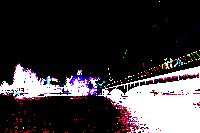
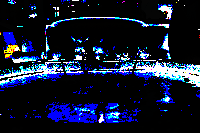
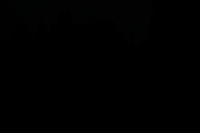
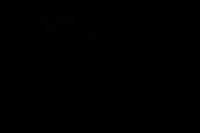
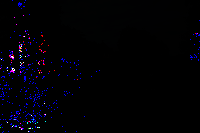
...
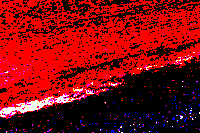
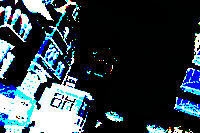
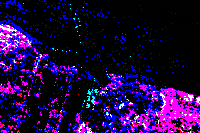
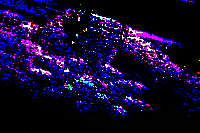
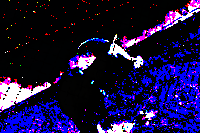

In [203]:
ipyplot.plot_images(test_x, img_width=200)